In [ ]:
pip install fuzzywuzzy

In [ ]:
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
from fuzzywuzzy import process
import re

/usr/local/lib/python3.11/dist-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


# **Setup Data**

# Data Semua

In [ ]:
df = pd.read_csv("combined_dataset_terbaru_raw.csv")
df.head(3)

,conversation_id_str,created_at,favorite_count,full_text,id_str,image_url,in_reply_to_screen_name,lang,location,quote_count,reply_count,retweet_count,tweet_url,user_id_str,username
0,1774485185352122600,Sun Mar 31 23:24:25 +0000 2024,5,@Gank_Of_Petojo Total suara lebih banyak suara...,1774578528362864796,NaN,Gank_Of_Petojo,in,NaN,0,2,3,https://x.com/SuramaduJingga/status/1774578528...,749252554005983232,SuramaduJingga
1,1773824015402230156,Sun Mar 31 23:23:49 +0000 2024,2,@satriawiguna77 Mimpi ta klo pilpres minta diu...,1774578376751427775,NaN,satriawiguna77,in,young java,0,0,0,https://x.com/BudiHar73497395/status/177457837...,1504844579799187461,BudiHar73497395
2,1774578233041908194,Sun Mar 31 23:23:15 +0000 2024,0,Untuk apa Megawati ketemu dgn Prabowo pasca ke...,1774578233041908194,NaN,NaN,in,"Depok, Jawa Barat",0,0,0,https://x.com/SabaruddinS64/status/17745782330...,1716136366843822080,SabaruddinS64


In [ ]:
df = df.drop_duplicates()

# Data Sentimen

In [ ]:
dfs = pd.read_csv("Wrapped80.csv")
dfs.head(3)

,favorite_count,full_text,username,clean,case,slangword,tokenize,stopword,final,Sentimen
0,5,@Gank_Of_Petojo Total suara lebih banyak suara...,SuramaduJingga,gank of petojo total suara lebih banyak suara ...,gank of petojo total suara lebih banyak suara ...,gank of petojo total suara lebih banyak suara ...,"['gank', 'of', 'petojo', 'total', 'suara', 'le...","['gank', 'petojo', 'total', 'suara', 'suara', ...",gank petojo total suara suara pilpres dibandin...,"('negative', 0.9989824891090393)"
1,2,@satriawiguna77 Mimpi ta klo pilpres minta diu...,BudiHar73497395,satriawiguna mimpi ta klo pilpres minta diulan...,satriawiguna mimpi ta klo pilpres minta diulan...,satriawiguna mimpi ta kalau pilpres minta diul...,"['satriawiguna', 'mimpi', 'ta', 'kalau', 'pilp...","['satriawiguna', 'mimpi', 'ta', 'pilpres', 'di...",satriawiguna mimpi ta pilpres diulang orang tolol,"('neutral', 0.9940378665924072)"
2,0,Untuk apa Megawati ketemu dgn Prabowo pasca ke...,SabaruddinS64,untuk apa megawati ketemu dgn prabowo pasca ke...,untuk apa megawati ketemu dgn prabowo pasca ke...,untuk apa megawati ketemu dengan prabowo pasca...,"['untuk', 'apa', 'megawati', 'ketemu', 'dengan...","['megawati', 'ketemu', 'prabowo', 'pasca', 'ke...",megawati ketemu prabowo pasca keputusan mk ter...,"('negative', 0.9990377426147461)"


In [ ]:
import ast

# Ubah string ke tuple
dfs['Sentimen'] = dfs['Sentimen'].apply(ast.literal_eval)

In [ ]:
def convert_sentiment(label, score):
    if label == 'positive':
        return score
    elif label == 'negative':
        return -score
    else:
        return 0
dfs['sentiment_score'] = dfs['Sentimen'].apply(lambda x: convert_sentiment(*x))

In [ ]:
dfs.head(3)

,favorite_count,full_text,username,clean,case,slangword,tokenize,stopword,final,Sentimen,sentiment_score
0,5,@Gank_Of_Petojo Total suara lebih banyak suara...,SuramaduJingga,gank of petojo total suara lebih banyak suara ...,gank of petojo total suara lebih banyak suara ...,gank of petojo total suara lebih banyak suara ...,"['gank', 'of', 'petojo', 'total', 'suara', 'le...","['gank', 'petojo', 'total', 'suara', 'suara', ...",gank petojo total suara suara pilpres dibandin...,"(negative, 0.9989824891090393)",-0.998982
1,2,@satriawiguna77 Mimpi ta klo pilpres minta diu...,BudiHar73497395,satriawiguna mimpi ta klo pilpres minta diulan...,satriawiguna mimpi ta klo pilpres minta diulan...,satriawiguna mimpi ta kalau pilpres minta diul...,"['satriawiguna', 'mimpi', 'ta', 'kalau', 'pilp...","['satriawiguna', 'mimpi', 'ta', 'pilpres', 'di...",satriawiguna mimpi ta pilpres diulang orang tolol,"(neutral, 0.9940378665924072)",0.000000
2,0,Untuk apa Megawati ketemu dgn Prabowo pasca ke...,SabaruddinS64,untuk apa megawati ketemu dgn prabowo pasca ke...,untuk apa megawati ketemu dgn prabowo pasca ke...,untuk apa megawati ketemu dengan prabowo pasca...,"['untuk', 'apa', 'megawati', 'ketemu', 'dengan...","['megawati', 'ketemu', 'prabowo', 'pasca', 'ke...",megawati ketemu prabowo pasca keputusan mk ter...,"(negative, 0.9990377426147461)",-0.999038


In [ ]:
print(df.shape)
print(dfs.shape)

(8975, 15)
(8975, 11)


In [ ]:
df = df.join(dfs['sentiment_score'])

In [ ]:
df.head(1)

,conversation_id_str,created_at,favorite_count,full_text,id_str,image_url,in_reply_to_screen_name,lang,location,quote_count,reply_count,retweet_count,tweet_url,user_id_str,username,sentiment_score
0,1774485185352122600,Sun Mar 31 23:24:25 +0000 2024,5,@Gank_Of_Petojo Total suara lebih banyak suara...,1774578528362864796,NaN,Gank_Of_Petojo,in,NaN,0,2,3,https://x.com/SuramaduJingga/status/1774578528...,749252554005983232,SuramaduJingga,-0.998982


# Data Hate Speech

In [ ]:
df_hs = pd.read_csv("df_hs.csv")
df_hs.head(3)

,final,Prediksi_HS,Persentase
0,gank petojo total suara suara pilpres dibandin...,Non_HS,0.997006
1,satriawiguna mimpi ta pilpres diulang orang tolol,HS,0.997928
2,megawati ketemu prabowo pasca keputusan mk ter...,Non_HS,0.549940


In [ ]:
def convert_HS(label, score):
    if label == 'Non_HS':
        return score
    elif label == 'HS':
        return -score
    else:
        return 0
df_hs['Skor_Hate'] = df_hs.apply(lambda x: convert_HS(x['Prediksi_HS'], x['Persentase']), axis=1)

In [ ]:
df_hs

,final,Prediksi_HS,Persentase,Skor_Hate
0,gank petojo total suara suara pilpres dibandin...,Non_HS,0.997006,0.997006
1,satriawiguna mimpi ta pilpres diulang orang tolol,HS,0.997928,-0.997928
2,megawati ketemu prabowo pasca keputusan mk ter...,Non_HS,0.549940,0.549940
3,oposisicerdas windhixxx kader militan pilpres ...,HS,0.997731,-0.997731
4,kompascom berbicara sembarangan asumsi jokowi ...,Non_HS,0.998195,0.998195
...,...,...,...,...
8970,jamalboegis kpu id persentase dihitung memasuk...,Non_HS,0.990139,0.990139
8971,liniziohiraeth tevn peel intinya dr skandal ca...,HS,0.995586,-0.995586
8972,rcakra faizalassegaf ngitung gitu kaleee diitu...,HS,0.995825,-0.995825
8973,kompastv bikin pemilu ulang golongan putih pem...,Non_HS,0.985984,0.985984


In [ ]:
hs = pd.concat([df['location'],df_hs['Skor_Hate']],axis=1)

# **Setup Lokasi**

# Lokasi berdasarkan jumlah komentar

In [ ]:
df = df.dropna(subset=['location'])

In [ ]:
df['location'][50:100]

,location
109,"Jakarta Selatan, DKI Jakarta"
111,Indonesia
112,"DKI Jakarta, Indonesia"
114,indonesia
116,Indonesia
117,iNews Tower
118,"Jakarta Selatan, DKI Jakarta"
119,"Mandonga, Indonesia"
121,"Pulo Gadung, Indonesia"
122,"Pulo Gadung, Indonesia"


**Setup Lokasi**

In [ ]:
lokasi = df['location']

In [ ]:
provinsi = [
    "Aceh", "Sumatera Utara", "Sumatera Barat", "Riau", "Kepulauan Riau", "Jambi", "Bengkulu", "Sumatera Selatan",
    "Lampung", "Bangka Belitung", "DKI Jakarta", "Jawa Barat", "Jawa Tengah", "DI Yogyakarta", "Jawa Timur", "Banten",
    "Bali", "Nusa Tenggara Barat", "Nusa Tenggara Timur", "Kalimantan Barat", "Kalimantan Tengah", "Kalimantan Selatan",
    "Kalimantan Timur", "Kalimantan Utara", "Sulawesi Utara", "Sulawesi Tengah", "Sulawesi Selatan", "Sulawesi Tenggara",
    "Gorontalo", "Sulawesi Barat", "Maluku", "Maluku Utara", "Papua", "Papua Barat", "Papua Tengah", "Papua Selatan"
]

In [ ]:
def match_province(location):
    if pd.isna(location):
        return "Unknown"

    location = str(location).strip()

    if not re.search(r'[a-zA-Z]', location):
        return "Unknown"

    best_match, score = process.extractOne(location, provinsi)
    return best_match if score > 80 else "Unknown"

In [ ]:
df['location'] = df['location'].astype(str)
df['location'] = df['location'].apply(match_province)

print(df['location'])

0           Unknown
1           Unknown
2        Jawa Barat
3           Unknown
4           Unknown
            ...    
12060       Unknown
12061       Unknown
12062    Jawa Timur
12063       Unknown
12064       Unknown
Name: location, Length: 8975, dtype: object


In [ ]:
jml_provinsi =df['location'][df['location'] != 'Unknown'].value_counts().reset_index()

In [ ]:
jml_provinsi = jml_provinsi.sort_values(by='location')
jml_provinsi = jml_provinsi.rename(columns={'location': 'province'})
jml_provinsi.head()

,province,count
13,Aceh,19
5,Bali,57
22,Bangka Belitung,6
6,Banten,47
16,Bengkulu,15


In [ ]:
jml_provinsi

,province,count
14,Aceh,21
5,Bali,70
21,Bangka Belitung,8
6,Banten,68
16,Bengkulu,20
3,DI Yogyakarta,133
0,DKI Jakarta,1022
13,Gorontalo,22
15,Jambi,21
1,Jawa Barat,239


In [ ]:
jml_provinsi = jml_provinsi.replace({
    'DI Yogyakarta': 'Yogyakarta',
    'Bangka Belitung': 'Bangka-Belitung',
    'DKI Jakarta': 'Jakarta Raya'
})

# Lokasi berdasarkan sentimen

In [ ]:
jml_provinsi = df[df['location'] != 'Unknown']

sentimen_provinsi = jml_provinsi.groupby('location')['sentiment_score'].mean().reset_index()

sentimen_provinsi.columns = ['provinsi', 'sentimen']

In [ ]:
sentimen_provinsi

,provinsi,sentimen
0,Aceh,-0.277903
1,Bali,-0.319375
2,Bangka Belitung,0.159779
3,Banten,-0.325766
4,Bengkulu,-0.454485
5,DI Yogyakarta,-0.327620
6,DKI Jakarta,-0.262295
7,Gorontalo,-0.499593
8,Jambi,-0.562225
9,Jawa Barat,-0.174899


# Lokasi berdasarkan hate_speech

In [ ]:
hs['location'] = hs['location'].astype(str)
hs['location'] = hs['location'].apply(match_province)

print(hs['location'])

0          Unknown
1          Unknown
2       Jawa Barat
3          Unknown
4          Unknown
           ...    
8949       Unknown
8950       Unknown
8951       Unknown
8962       Unknown
8970       Unknown
Name: location, Length: 10524, dtype: object


In [ ]:
jml_provinsi = hs[hs['location'] != 'Unknown']
hs_provinsi = jml_provinsi.groupby('location', as_index=False)['Skor_Hate'].mean()
hs_provinsi.columns = ['provinsi', 'Hate_Speech']

In [ ]:
hs_provinsi.head(20)

,provinsi,Hate_Speech
0,Aceh,0.020628
1,Bali,0.022947
2,Bangka Belitung,-0.249586
3,Banten,0.422568
4,Bengkulu,0.345108
5,DI Yogyakarta,0.038146
6,DKI Jakarta,0.139988
7,Gorontalo,0.546440
8,Jambi,0.254881
9,Jawa Barat,0.256003


In [ ]:
hs_provinsi = hs_provinsi.replace({
    'DI Yogyakarta': 'Yogyakarta',
    'Bangka Belitung': 'Bangka-Belitung',
    'DKI Jakarta': 'Jakarta Raya'
})

# **Setup Map**

In [ ]:
fp = "IDN_adm1.shp"
map_df = gpd.read_file(fp)
map_df.head()

,ID_0,ISO,NAME_0,ID_1,NAME_1,TYPE_1,ENGTYPE_1,NL_NAME_1,VARNAME_1,geometry
0,106,IDN,Indonesia,1,Aceh,Propinsi,Autonomous Province,None,Achin|Atjeh|Nanggroe Aceh Darussalam,"MULTIPOLYGON (((97.38493 1.97713, 97.38396 1.9..."
1,106,IDN,Indonesia,2,Bali,Propinsi,Province,None,Penida|Lembongan|Ceningan|Menjangan,"MULTIPOLYGON (((115.62988 -8.77599, 115.63037 ..."
2,106,IDN,Indonesia,3,Bangka-Belitung,Propinsi,Province,None,Babel|Kepulauan Bangka Belitung,"MULTIPOLYGON (((108.06951 -3.80305, 108.06826 ..."
3,106,IDN,Indonesia,4,Banten,Propinsi,Province,None,None,"MULTIPOLYGON (((105.54861 -6.99472, 105.54889 ..."
4,106,IDN,Indonesia,5,Bengkulu,Propinsi,Province,None,Bencoolen|Benkoelen|Benkulen,"MULTIPOLYGON (((102.38627 -5.47112, 102.38682 ..."


In [ ]:
province = pd.read_csv("https://raw.githubusercontent.com/mrakelinggar/data-stuffs/refs/heads/master/cloropleth_python/data_province.csv", delimiter=";")

In [ ]:
province.head(5)

,province,population_2015,area_km2,population_density_per_km2,cities_regencies,cities,regencies
0,Jawa Timur,38828061,48,828,38,9,29
1,Jawa Tengah,33753023,41,894,35,6,29
2,Sumatera Utara,13923262,73,188,33,8,25
3,Papua,3143088,319,8,29,1,28
4,Jawa Barat,46668214,35,1,27,9,18


<Axes: >

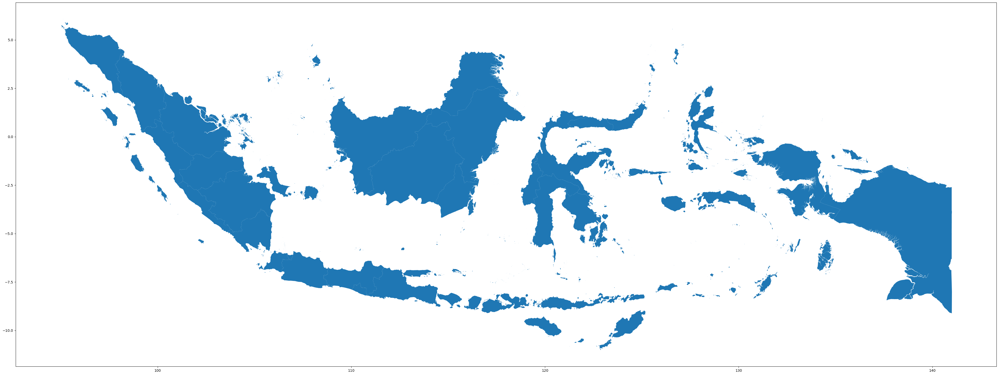

In [ ]:
plt.rcParams['figure.figsize'] = [50, 70]
map_df.plot()

In [ ]:
merged = map_df.merge(province, how='left', left_on="NAME_1", right_on="province")
merged = merged[['province', 'geometry', 'population_2015', 'area_km2', 'population_density_per_km2', \
                'cities_regencies', 'cities', 'regencies']]

merged.head()

,province,geometry,population_2015,area_km2,population_density_per_km2,cities_regencies,cities,regencies
0,Aceh,"MULTIPOLYGON (((97.38493 1.97713, 97.38396 1.9...",4993385.0,58.0,77.0,23.0,5,18.0
1,Bali,"MULTIPOLYGON (((115.62988 -8.77599, 115.63037 ...",4148588.0,6.0,621.0,9.0,1,8.0
2,Bangka-Belitung,"MULTIPOLYGON (((108.06951 -3.80305, 108.06826 ...",1370331.0,16.0,64.0,7.0,1,6.0
3,Banten,"MULTIPOLYGON (((105.54861 -6.99472, 105.54889 ...",11934373.0,10.0,909.0,8.0,4,4.0
4,Bengkulu,"MULTIPOLYGON (((102.38627 -5.47112, 102.38682 ...",1872136.0,20.0,84.0,10.0,1,9.0


# **Merging Data**

# Count

In [ ]:
gabung = merged.merge(jml_provinsi, how='left', left_on="province", right_on="province")
gabung = gabung[['province', 'geometry', 'count']]

In [ ]:
gabung.dropna()

,province,geometry,count
0,Aceh,"MULTIPOLYGON (((97.38493 1.97713, 97.38396 1.9...",19.0
1,Bali,"MULTIPOLYGON (((115.62988 -8.77599, 115.63037 ...",57.0
2,Bangka-Belitung,"MULTIPOLYGON (((108.06951 -3.80305, 108.06826 ...",6.0
3,Banten,"MULTIPOLYGON (((105.54861 -6.99472, 105.54889 ...",47.0
4,Bengkulu,"MULTIPOLYGON (((102.38627 -5.47112, 102.38682 ...",15.0
5,Gorontalo,"MULTIPOLYGON (((122.12139 0.40583, 122.12167 0...",19.0
7,Jakarta Raya,"MULTIPOLYGON (((106.73338 -6.09776, 106.73373 ...",782.0
8,Jambi,"MULTIPOLYGON (((104.21628 -1.06326, 104.21578 ...",16.0
9,Jawa Barat,"MULTIPOLYGON (((107.85297 -7.73661, 107.8533 -...",174.0
10,Jawa Tengah,"MULTIPOLYGON (((109.01002 -7.68037, 109.01002 ...",69.0


In [ ]:
nama_sulteng = merged['province'][28]
lokasi_sulteng = merged['geometry'][28]

In [ ]:
gabung.loc[len(gabung)] = [nama_sulteng , lokasi_sulteng , 0]

# Sentimen

In [ ]:
sentimen_provinsi = sentimen_provinsi.replace({
    'DI Yogyakarta': 'Yogyakarta',
    'Bangka Belitung': 'Bangka-Belitung',
    'DKI Jakarta': 'Jakarta Raya'
})

In [ ]:
gabung_sentimen = merged.merge(sentimen_provinsi, how='left', left_on="province", right_on="provinsi")
gabung_sentimen = gabung_sentimen[['provinsi', 'geometry', 'sentimen']]

In [ ]:
nama_sulteng = merged['province'][28]
lokasi_sulteng = merged['geometry'][28]

In [ ]:
gabung_sentimen.loc[len(gabung_sentimen)] = [nama_sulteng , lokasi_sulteng , 0]

In [ ]:
gabung_sentimen.dropna()

,provinsi,geometry,sentimen
0,Aceh,"MULTIPOLYGON (((97.38493 1.97713, 97.38396 1.9...",-0.277903
1,Bali,"MULTIPOLYGON (((115.62988 -8.77599, 115.63037 ...",-0.319375
2,Bangka-Belitung,"MULTIPOLYGON (((108.06951 -3.80305, 108.06826 ...",0.159779
3,Banten,"MULTIPOLYGON (((105.54861 -6.99472, 105.54889 ...",-0.325766
4,Bengkulu,"MULTIPOLYGON (((102.38627 -5.47112, 102.38682 ...",-0.454485
5,Gorontalo,"MULTIPOLYGON (((122.12139 0.40583, 122.12167 0...",-0.499593
7,Jakarta Raya,"MULTIPOLYGON (((106.73338 -6.09776, 106.73373 ...",-0.262295
8,Jambi,"MULTIPOLYGON (((104.21628 -1.06326, 104.21578 ...",-0.562225
9,Jawa Barat,"MULTIPOLYGON (((107.85297 -7.73661, 107.8533 -...",-0.174899
10,Jawa Tengah,"MULTIPOLYGON (((109.01002 -7.68037, 109.01002 ...",-0.341778


In [ ]:
gabung_sentimen.describe()

,sentimen
count,30.000000
mean,-0.241673
std,0.286722
min,-0.798801
25%,-0.408917
50%,-0.267709
75%,-0.032254
max,0.497385


# Hate Speech

In [ ]:
gabung_hs = merged.merge(hs_provinsi, how='left', left_on="province", right_on="provinsi")
gabung_hs = gabung_hs[['provinsi', 'geometry', 'Hate_Speech']]

In [ ]:
gabung_hs.dropna()

,provinsi,geometry,Hate_Speech
0,Aceh,"MULTIPOLYGON (((97.38493 1.97713, 97.38396 1.9...",0.020628
1,Bali,"MULTIPOLYGON (((115.62988 -8.77599, 115.63037 ...",0.022947
2,Bangka-Belitung,"MULTIPOLYGON (((108.06951 -3.80305, 108.06826 ...",-0.249586
3,Banten,"MULTIPOLYGON (((105.54861 -6.99472, 105.54889 ...",0.422568
4,Bengkulu,"MULTIPOLYGON (((102.38627 -5.47112, 102.38682 ...",0.345108
5,Gorontalo,"MULTIPOLYGON (((122.12139 0.40583, 122.12167 0...",0.546440
7,Jakarta Raya,"MULTIPOLYGON (((106.73338 -6.09776, 106.73373 ...",0.139988
8,Jambi,"MULTIPOLYGON (((104.21628 -1.06326, 104.21578 ...",0.254881
9,Jawa Barat,"MULTIPOLYGON (((107.85297 -7.73661, 107.8533 -...",0.256003
10,Jawa Tengah,"MULTIPOLYGON (((109.01002 -7.68037, 109.01002 ...",0.092132


# **Persebaran Daerah**

Dibagi dalam banyak komentar per provinsi

**Count**

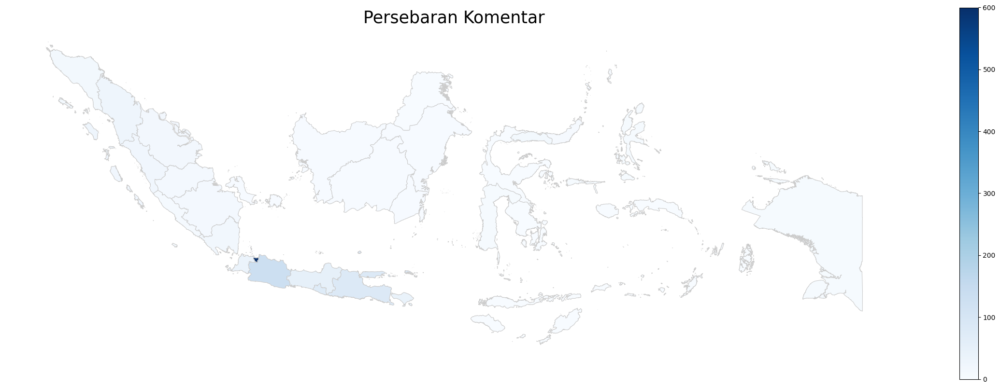

In [ ]:
variable = 'count'
vmin, vmax = 0, 600
fig, ax = plt.subplots(1, figsize=(30, 10))
ax.axis('off')

ax.set_title('Persebaran Komentar', fontdict={'fontsize': '25', 'fontweight' : '3'})

sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

gabung.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

gabung['coords'] = gabung['geometry'].apply(lambda x: x.representative_point().coords[:])

<Axes: title={'center': 'Persebaran Komentar (Klasifikasi)'}>

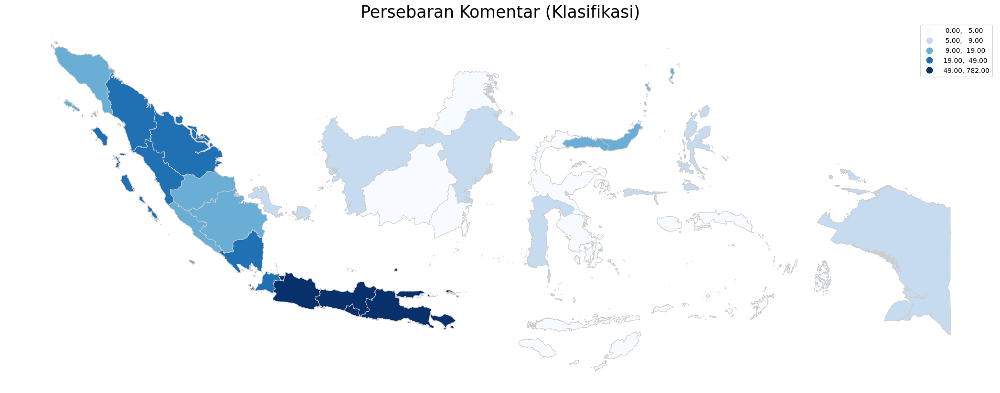

In [ ]:
import mapclassify

fig, ax = plt.subplots(1, figsize=(30, 10))
ax.axis('off')
ax.set_title('Persebaran Komentar (Klasifikasi)', fontdict={'fontsize': '25', 'fontweight': '3'})

gabung.plot(column='count', cmap='Blues', scheme='quantiles', k=5, linewidth=0.8, ax=ax, edgecolor='0.8', legend=True)


<Axes: title={'center': 'Comment Distribution'}>

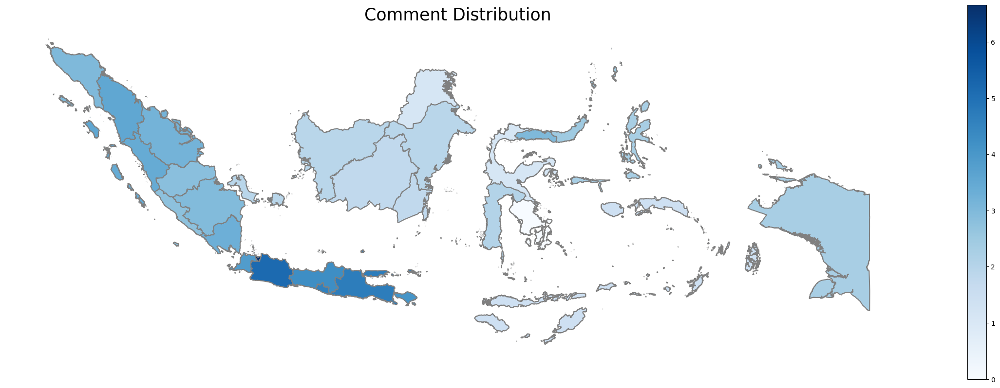

In [ ]:
gabung['log_count'] = np.log1p(gabung['count'])
variable = 'log_count'
vmin, vmax = gabung[variable].min(), gabung[variable].max()

fig, ax = plt.subplots(1, figsize=(30, 10))
ax.axis('off')
ax.set_title('Comment Distribution', fontdict={'fontsize': '25', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

gabung.plot(
    column=variable,
    cmap='Blues',
    linewidth=1.5,
    ax=ax,
    edgecolor='grey'
)


In [ ]:
gabung

,province,geometry,count,coords,log_count
0,Aceh,"MULTIPOLYGON (((97.38493 1.97713, 97.38396 1.9...",19.0,"[(97.12480404398585, 3.9015370607376383)]",2.995732
1,Bali,"MULTIPOLYGON (((115.62988 -8.77599, 115.63037 ...",57.0,"[(115.27205280308743, -8.455256938934298)]",4.060443
2,Bangka-Belitung,"MULTIPOLYGON (((108.06951 -3.80305, 108.06826 ...",6.0,"[(107.90521049499533, -2.900418996810913)]",1.945910
3,Banten,"MULTIPOLYGON (((105.54861 -6.99472, 105.54889 ...",47.0,"[(106.13694206643069, -6.437360048293982)]",3.871201
4,Bengkulu,"MULTIPOLYGON (((102.38627 -5.47112, 102.38682 ...",15.0,"[(102.47335895490332, -3.6011320352553753)]",2.772589
5,Gorontalo,"MULTIPOLYGON (((122.12139 0.40583, 122.12167 0...",19.0,"[(122.2570228498374, 0.6724250018596933)]",2.995732
6,Irian Jaya Barat,"MULTIPOLYGON (((133.50668 -4.32504, 133.50676 ...",NaN,"[(130.07208236795393, -1.8673609495162395)]",NaN
7,Jakarta Raya,"MULTIPOLYGON (((106.73338 -6.09776, 106.73373 ...",782.0,"[(106.84621273345961, -6.232659816741915)]",6.663133
8,Jambi,"MULTIPOLYGON (((104.21628 -1.06326, 104.21578 ...",16.0,"[(102.48547443586307, -1.7582545280456259)]",2.833213
9,Jawa Barat,"MULTIPOLYGON (((107.85297 -7.73661, 107.8533 -...",174.0,"[(107.61218542907528, -6.8675689697265625)]",5.164786


Sentimen

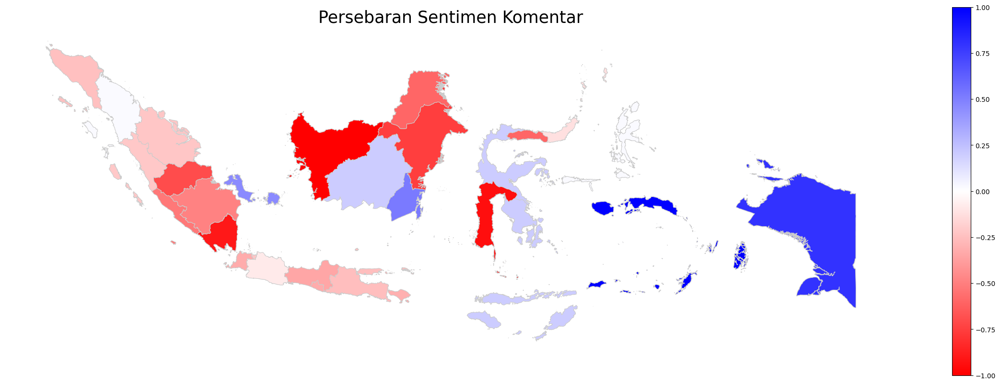

In [ ]:
variable = 'sentimen'
vmin, vmax = -1, 1
fig, ax = plt.subplots(1, figsize=(30, 10))
ax.axis('off')

ax.set_title('Persebaran Sentimen Komentar', fontdict={'fontsize': '25', 'fontweight' : '3'})

sm = plt.cm.ScalarMappable(cmap='bwr_r', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

gabung_sentimen.plot(column=variable, cmap='bwr_r', linewidth=0.8, ax=ax, edgecolor='0.8')

gabung_sentimen['coords'] = gabung_sentimen['geometry'].apply(lambda x: x.representative_point().coords[:])

**Exclude Jakarta**

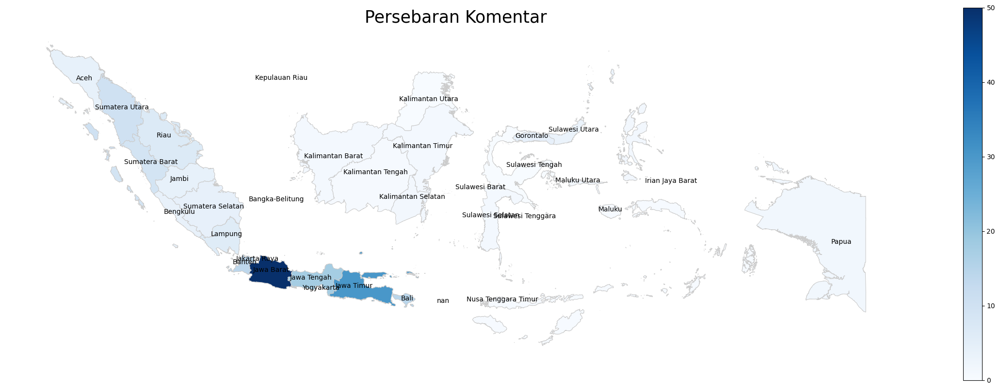

In [ ]:
variable = 'count'
vmin, vmax = 0, 50
fig, ax = plt.subplots(1, figsize=(30, 10))
ax.axis('off')

ax.set_title('Persebaran Komentar', fontdict={'fontsize': '25', 'fontweight' : '3'})

sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

gabung.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

gabung['coords'] = gabung['geometry'].apply(lambda x: x.representative_point().coords[:])
gabung['coords'] = [coords[0] for coords in merged['coords']]

for idx, row in merged.iterrows():
    plt.annotate(text=row['province'], xy=row['coords'], horizontalalignment='center')

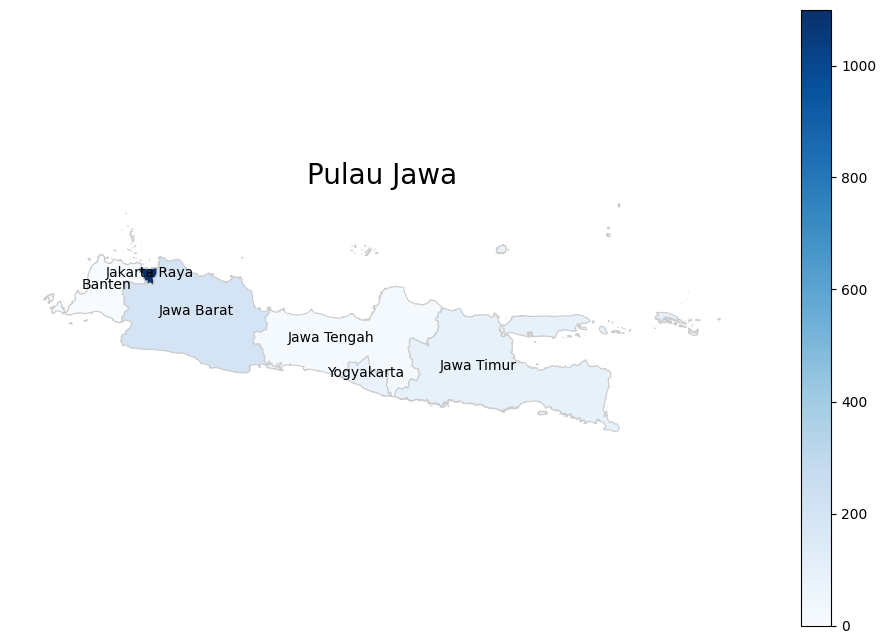

In [ ]:
provinsi_jawa = ['Banten', 'Jakarta Raya', 'Jawa Barat', 'Jawa Tengah', 'Yogyakarta', 'Jawa Timur']

gabung_jawa = gabung[gabung['province'].isin(provinsi_jawa)].copy()

variable = 'count'
vmin, vmax = 0, 1100
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')

ax.set_title('Pulau Jawa', fontdict={'fontsize': '20', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

gabung_jawa.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

gabung_jawa['coords'] = gabung_jawa['geometry'].apply(lambda x: x.representative_point().coords[:])
gabung_jawa['coords'] = [coords[0] for coords in gabung_jawa['coords']]

for idx, row in gabung_jawa.iterrows():
    plt.annotate(text=row['province'], xy=row['coords'], horizontalalignment='center')


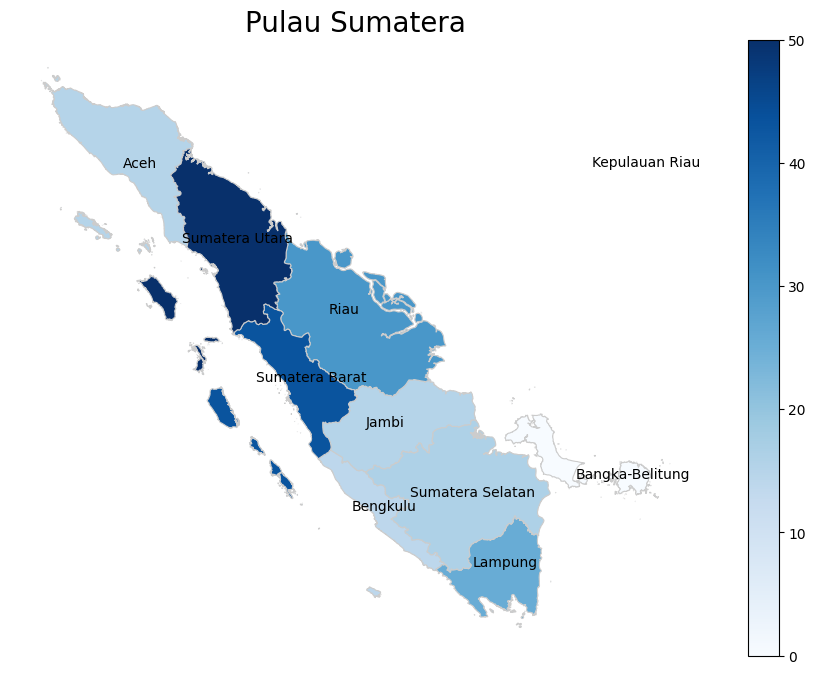

In [ ]:
sumatera = ['Aceh', 'Sumatera Utara', 'Sumatera Barat', 'Riau', 'Kepulauan Riau', 'Jambi','Bengkulu', 'Sumatera Selatan', 'Lampung', 'Bangka-Belitung']

gabung_sumatera = gabung[gabung['province'].isin(sumatera)].copy()

variable = 'count'
vmin, vmax = 0, 50
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')

ax.set_title('Pulau Sumatera', fontdict={'fontsize': '20', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

gabung_sumatera.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

gabung_sumatera['coords'] = gabung_sumatera['geometry'].apply(lambda x: x.representative_point().coords[:])
gabung_sumatera['coords'] = [coords[0] for coords in gabung_sumatera['coords']]

for idx, row in gabung_sumatera.iterrows():
    plt.annotate(text=row['province'], xy=row['coords'], horizontalalignment='center')


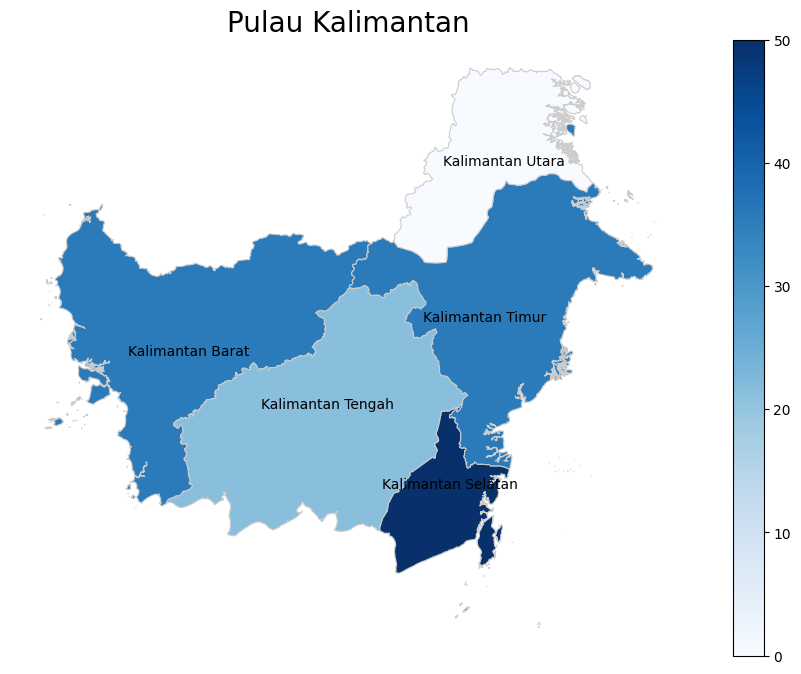

In [ ]:
kalimantan = ['Kalimantan Barat', 'Kalimantan Selatan', 'Kalimantan Tengah', 'Kalimantan Timur', 'Kalimantan Utara']

kalimantan = gabung[gabung['province'].isin(kalimantan)].copy()

variable = 'count'
vmin, vmax = 0, 50
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')

ax.set_title('Pulau Kalimantan', fontdict={'fontsize': '20', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

kalimantan.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

kalimantan['coords'] = kalimantan['geometry'].apply(lambda x: x.representative_point().coords[:])
kalimantan['coords'] = [coords[0] for coords in kalimantan['coords']]

for idx, row in kalimantan.iterrows():
    plt.annotate(text=row['province'], xy=row['coords'], horizontalalignment='center')


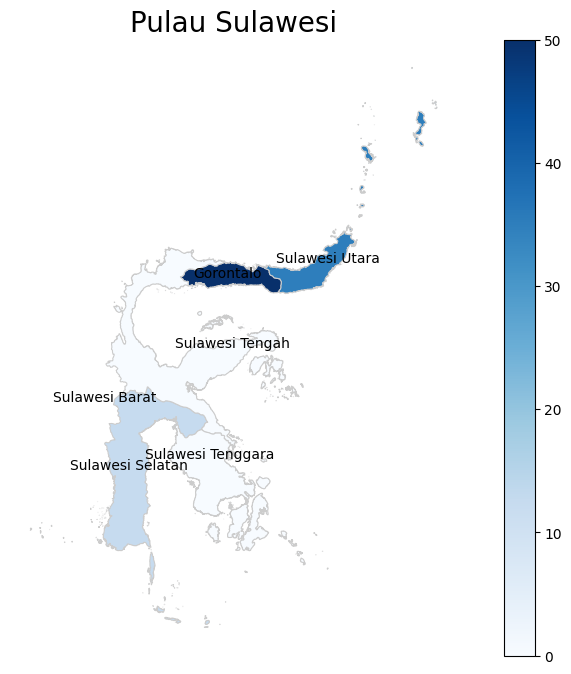

In [ ]:
Sulawesi = ['Sulawesi Utara', 'Sulawesi Tengah', 'Sulawesi Selatan', 'Sulawesi Barat', 'Gorontalo']
Sulawesi_Tenggara = merged['geometry'][28]

sulteng = gpd.GeoDataFrame({
    'province': ['Sulawesi Tenggara'],
    'count': [12],
    'geometry': [Sulawesi_Tenggara]
}, crs="EPSG:4326")

Sulawesi = gabung[gabung['province'].isin(Sulawesi)].copy()

variable = 'count'
vmin, vmax = 0, 50
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')

ax.set_title('Pulau Sulawesi', fontdict={'fontsize': '20', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

Sulawesi.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')
sulteng.plot(column='count', cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')


Sulawesi['coords'] = Sulawesi['geometry'].apply(lambda x: x.representative_point().coords[:])
Sulawesi['coords'] = [coords[0] for coords in Sulawesi['coords']]

sulteng['coords'] = sulteng['geometry'].apply(lambda x: x.representative_point().coords[:])
sulteng['coords'] = [coords[0] for coords in sulteng['coords']]

for idx, row in sulteng.iterrows():
    x, y = row['coords']
    plt.annotate(text=row['province'], xy=(x, y + 0.3), horizontalalignment='center')

for idx, row in Sulawesi.iterrows():
    plt.annotate(text=row['province'], xy=row['coords'], horizontalalignment='center')


# **Sentimen per Pulau**

**Note**

1: Positif

0: Netral

-1: Negatif

In [ ]:
import matplotlib.font_manager as fm
from matplotlib import patheffects as path_effects
from matplotlib.colors import LinearSegmentedColormap
font_path = '/content/AncizarSerif-Italic-VariableFont_wght.ttf'

sent_cmap = LinearSegmentedColormap.from_list("custom_sentimen", ["#fc2525", "#fff5f0" ,"#1E90FF"])
font_prop = fm.FontProperties(fname=font_path, weight= 'bold')

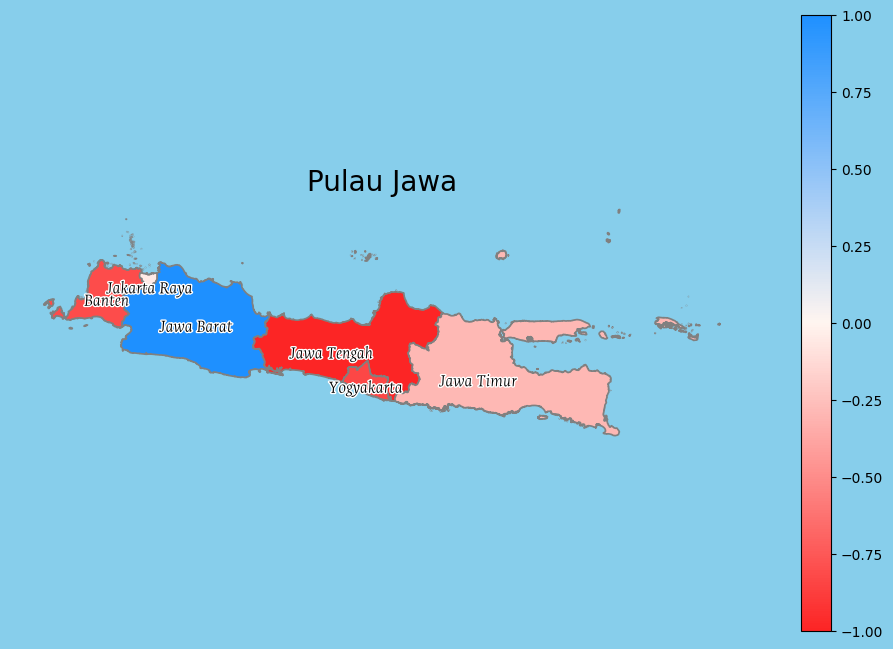

In [ ]:
provinsi_jawa = ['Banten', 'Jakarta Raya', 'Jawa Barat', 'Jawa Tengah', 'Yogyakarta', 'Jawa Timur']

gabung_jawa = gabung_sentimen[gabung_sentimen['provinsi'].isin(provinsi_jawa)].copy()

variable = 'sentimen'
vmin, vmax = -1, 1
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')

ax.set_title('Pulau Jawa', fontdict={'fontsize': '20', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap= sent_cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

gabung_jawa.plot(column=variable, cmap= sent_cmap, linewidth=1.2, ax=ax, edgecolor='gray')

gabung_jawa['coords'] = gabung_jawa['geometry'].apply(lambda x: x.representative_point().coords[:])
gabung_jawa['coords'] = [coords[0] for coords in gabung_jawa['coords']]
fig.patch.set_facecolor('skyblue')
for idx, row in gabung_jawa.iterrows():
    txt = plt.annotate(text=row['provinsi'], xy=row['coords'], horizontalalignment='center', verticalalignment='top', fontproperties=font_prop, fontsize=13)
    txt.set_path_effects([
        path_effects.Stroke(linewidth=2, foreground='white'),
        path_effects.Normal()
    ])

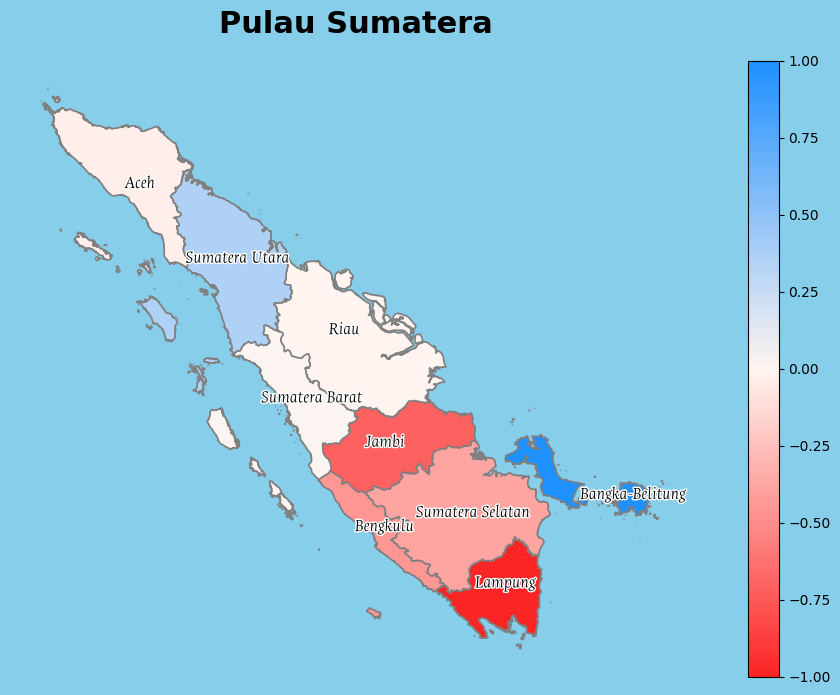

In [ ]:
sumatera = ['Aceh', 'Sumatera Utara', 'Sumatera Barat', 'Riau', 'Kepulauan Riau', 'Jambi','Bengkulu', 'Sumatera Selatan', 'Lampung', 'Bangka-Belitung']

gabung_sumatera = gabung_sentimen[gabung_sentimen['provinsi'].isin(sumatera)].copy()

variable = 'sentimen'
vmin, vmax = -1, 1
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')
ax.set_title('Pulau Sumatera', fontdict={'fontsize': 22, 'fontweight': 'bold'}, pad=20)

sm = plt.cm.ScalarMappable(cmap=sent_cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

gabung_sumatera.plot(column=variable, cmap=sent_cmap, linewidth=1.2, ax=ax, edgecolor='gray')

gabung_sumatera['coords'] = gabung_sumatera['geometry'].apply(lambda x: x.representative_point().coords[:])
gabung_sumatera['coords'] = [coords[0] for coords in gabung_sumatera['coords']]
fig.patch.set_facecolor('skyblue')
for idx, row in gabung_sumatera.iterrows():
    txt = plt.annotate(text=row['provinsi'], xy=row['coords'], horizontalalignment='center', fontproperties=font_prop, fontsize=13)
    txt.set_path_effects([
        path_effects.Stroke(linewidth=2, foreground='white'),
        path_effects.Normal()
    ])

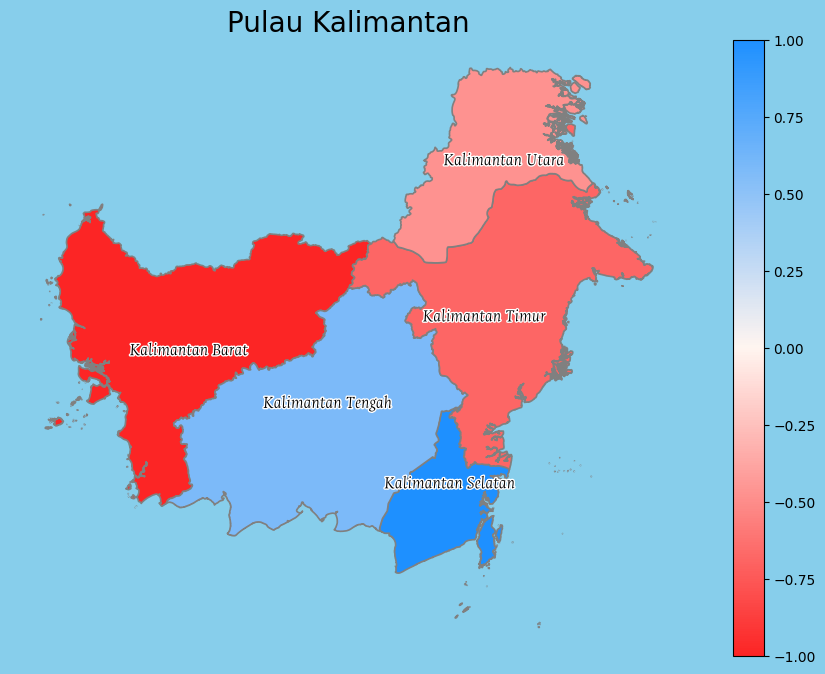

In [ ]:
kalimantan = ['Kalimantan Barat', 'Kalimantan Selatan', 'Kalimantan Tengah', 'Kalimantan Timur', 'Kalimantan Utara']

kalimantan = gabung_sentimen[gabung_sentimen['provinsi'].isin(kalimantan)].copy()

variable = 'sentimen'
vmin, vmax = -1, 1
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')

ax.set_title('Pulau Kalimantan', fontdict={'fontsize': '20', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap=sent_cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

kalimantan.plot(column=variable, cmap=sent_cmap, linewidth=1.2, ax=ax, edgecolor='gray')

kalimantan['coords'] = kalimantan['geometry'].apply(lambda x: x.representative_point().coords[:])
kalimantan['coords'] = [coords[0] for coords in kalimantan['coords']]
fig.patch.set_facecolor('skyblue')
for idx, row in kalimantan.iterrows():
    txt = plt.annotate(text=row['provinsi'], xy=row['coords'], horizontalalignment='center', fontproperties=font_prop, fontsize=13)
    txt.set_path_effects([
        path_effects.Stroke(linewidth=2, foreground='white'),
        path_effects.Normal()
    ])

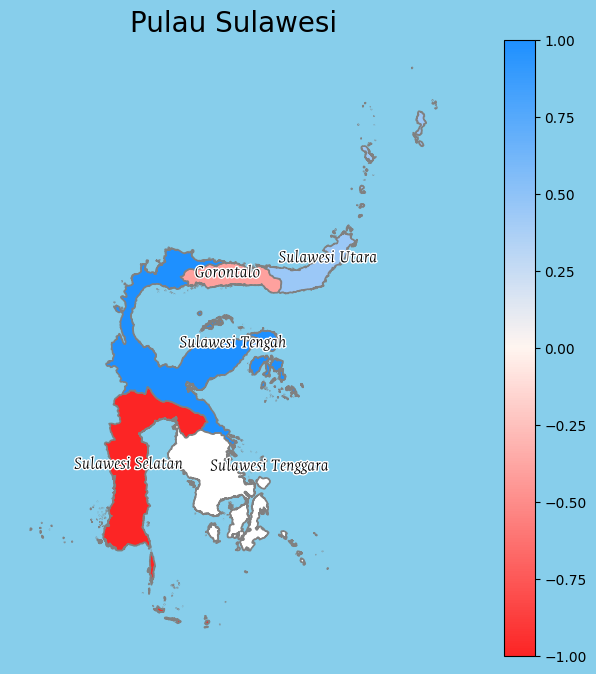

In [ ]:
Sulawesi = ['Sulawesi Utara', 'Sulawesi Tengah', 'Sulawesi Selatan', 'Sulawesi Barat', 'Gorontalo']
Sulawesi_Tenggara = merged['geometry'][28]

sulteng = gpd.GeoDataFrame({
    'province': ['Sulawesi Tenggara'],
    'sentimen': [0],
    'geometry': [Sulawesi_Tenggara]
}, crs="EPSG:4326")

Sulawesi = gabung_sentimen[gabung_sentimen['provinsi'].isin(Sulawesi)].copy()

variable = 'sentimen'
vmin, vmax = -1, 1
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')

ax.set_title('Pulau Sulawesi', fontdict={'fontsize': '20', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap=sent_cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

Sulawesi.plot(column=variable, cmap=sent_cmap, linewidth=1.2, ax=ax, edgecolor='gray')
sulteng.plot(column='sentimen', cmap='Grays', linewidth=1.2, ax=ax, edgecolor='gray')


Sulawesi['coords'] = Sulawesi['geometry'].apply(lambda x: x.representative_point().coords[:])
Sulawesi['coords'] = [coords[0] for coords in Sulawesi['coords']]

sulteng['coords'] = sulteng['geometry'].apply(lambda x: x.representative_point().coords[:])
sulteng['coords'] = [coords[0] for coords in sulteng['coords']]

for idx, row in sulteng.iterrows():
    x, y = row['coords']
    txt = plt.annotate(text=row['province'], xy=row['coords'], horizontalalignment='left', fontproperties=font_prop, fontsize=13)
    txt.set_path_effects([
        path_effects.Stroke(linewidth=2, foreground='white'),
        path_effects.Normal()
    ])
fig.patch.set_facecolor('skyblue')
for idx, row in Sulawesi.iterrows():
    txt = plt.annotate(text=row['provinsi'], xy=row['coords'], horizontalalignment='center', fontproperties=font_prop, fontsize=13)
    txt.set_path_effects([
        path_effects.Stroke(linewidth=2, foreground='white'),
        path_effects.Normal()
    ])


# **Hate Speech per Pulau**

**Note**

1: Non Hate-Speech

-1: Hate-Speech

In [ ]:
import matplotlib.font_manager as fm
from matplotlib import patheffects as path_effects
from matplotlib.colors import LinearSegmentedColormap

font_path = '/content/AncizarSerif-Italic-VariableFont_wght.ttf'


font_prop = fm.FontProperties(fname=font_path, weight= 'bold')
red_cmap = LinearSegmentedColormap.from_list("custom_red", ["#ff0e0e", "#ffd1d1"])

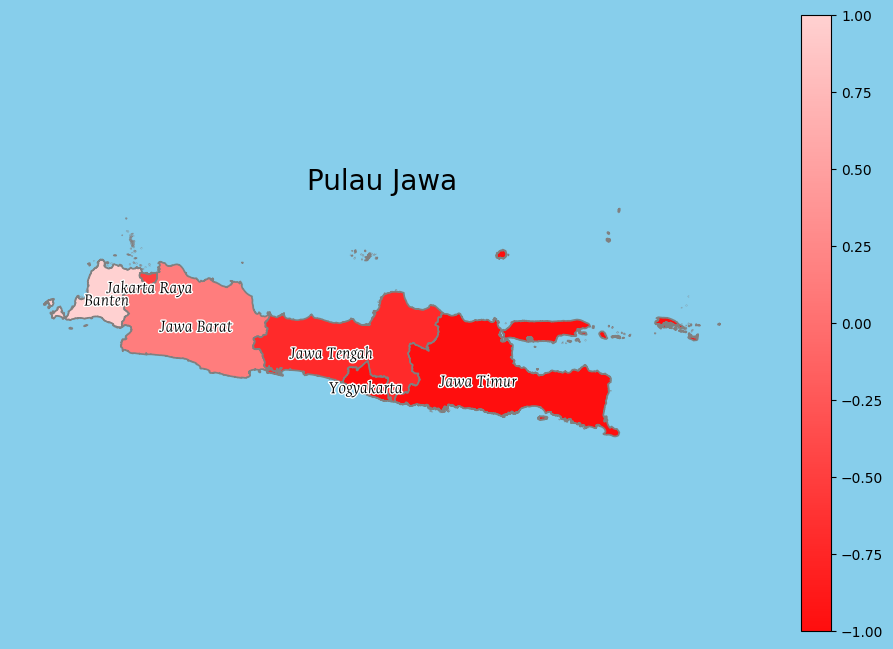

In [ ]:
provinsi_jawa = ['Banten', 'Jakarta Raya', 'Jawa Barat', 'Jawa Tengah', 'Yogyakarta', 'Jawa Timur']

gabung_jawa = gabung_hs[gabung_hs['provinsi'].isin(provinsi_jawa)].copy()

variable = 'Hate_Speech'
vmin, vmax = -1, 1
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')

ax.set_title('Pulau Jawa', fontdict={'fontsize': '20', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap=red_cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

gabung_jawa.plot(column=variable, cmap=red_cmap, linewidth=1.2, ax=ax, edgecolor='gray')

gabung_jawa['coords'] = gabung_jawa['geometry'].apply(lambda x: x.representative_point().coords[:])
gabung_jawa['coords'] = [coords[0] for coords in gabung_jawa['coords']]
fig.patch.set_facecolor('skyblue')
for idx, row in gabung_jawa.iterrows():
    txt = plt.annotate(text=row['provinsi'], xy=row['coords'], horizontalalignment='center', verticalalignment='top', fontproperties=font_prop, fontsize=13)
    txt.set_path_effects([
        path_effects.Stroke(linewidth=2, foreground='white'),
        path_effects.Normal()
    ])

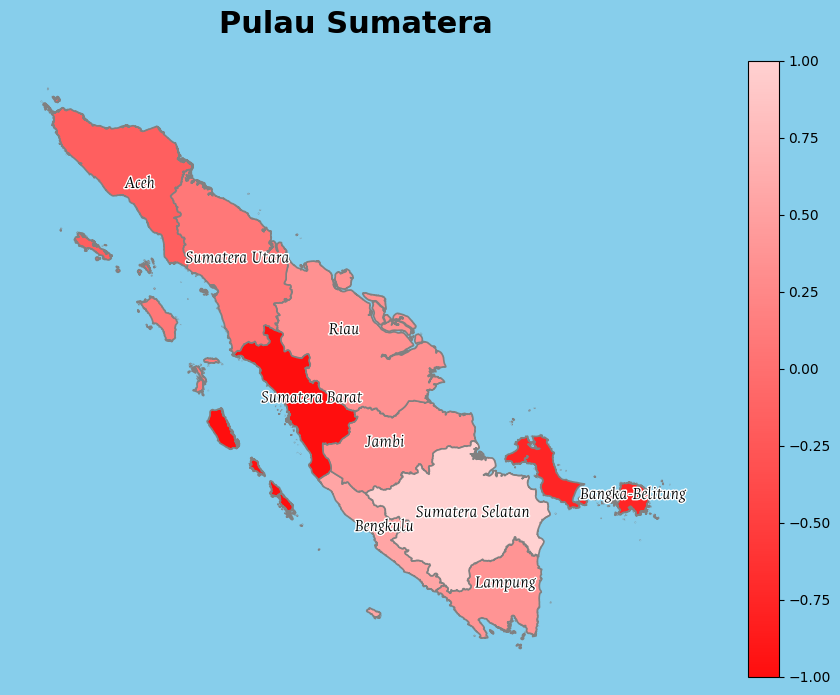

In [ ]:
sumatera = ['Aceh', 'Sumatera Utara', 'Sumatera Barat', 'Riau', 'Kepulauan Riau', 'Jambi','Bengkulu', 'Sumatera Selatan', 'Lampung', 'Bangka-Belitung']

gabung_sumatera = gabung_hs[gabung_hs['provinsi'].isin(sumatera)].copy()

variable = 'Hate_Speech'
vmin, vmax = -1, 1
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')
ax.set_title('Pulau Sumatera', fontdict={'fontsize': 22, 'fontweight': 'bold'}, pad=20)

sm = plt.cm.ScalarMappable(cmap= red_cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

gabung_sumatera.plot(column=variable, cmap= red_cmap, linewidth=1.2, ax=ax, edgecolor='gray')

gabung_sumatera['coords'] = gabung_sumatera['geometry'].apply(lambda x: x.representative_point().coords[:])
gabung_sumatera['coords'] = [coords[0] for coords in gabung_sumatera['coords']]
fig.patch.set_facecolor('skyblue')
for idx, row in gabung_sumatera.iterrows():
    txt = plt.annotate(text=row['provinsi'], xy=row['coords'], horizontalalignment='center', fontproperties=font_prop, fontsize=13)
    txt.set_path_effects([
        path_effects.Stroke(linewidth=2, foreground='white'),
        path_effects.Normal()
    ])

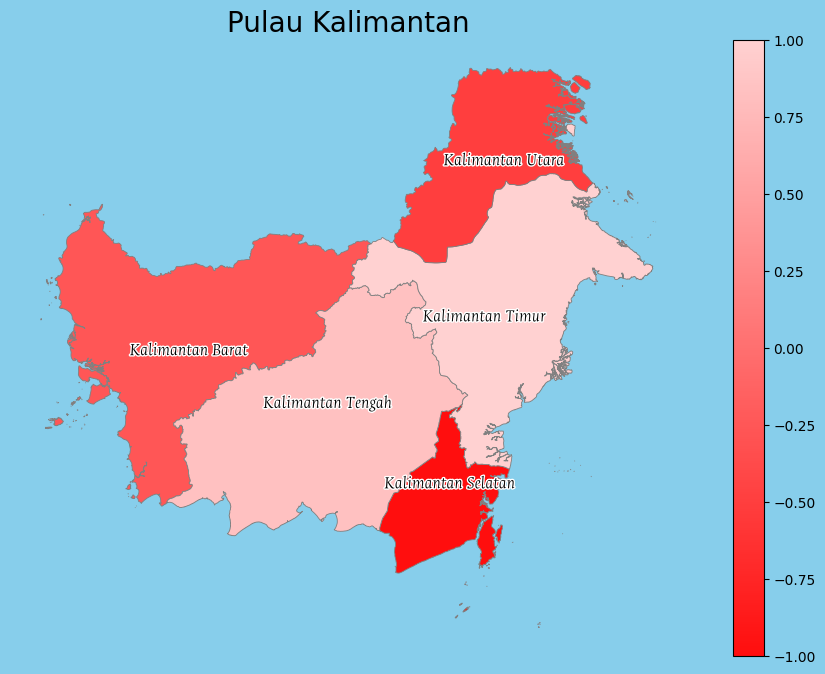

In [ ]:
kalimantan = ['Kalimantan Barat', 'Kalimantan Selatan', 'Kalimantan Tengah', 'Kalimantan Timur', 'Kalimantan Utara']

kalimantan = gabung_hs[gabung_hs['provinsi'].isin(kalimantan)].copy()

variable = 'Hate_Speech'
vmin, vmax = -1, 1
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')

ax.set_title('Pulau Kalimantan', fontdict={'fontsize': '20', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap= red_cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

kalimantan.plot(column=variable, cmap= red_cmap, linewidth= 0.6, ax=ax, edgecolor='gray')

kalimantan['coords'] = kalimantan['geometry'].apply(lambda x: x.representative_point().coords[:])
kalimantan['coords'] = [coords[0] for coords in kalimantan['coords']]
fig.patch.set_facecolor('skyblue')
for idx, row in kalimantan.iterrows():
    txt = plt.annotate(text=row['provinsi'], xy=row['coords'], horizontalalignment='center', fontproperties=font_prop, fontsize=13)
    txt.set_path_effects([
        path_effects.Stroke(linewidth=2, foreground='white'),
        path_effects.Normal()
    ])

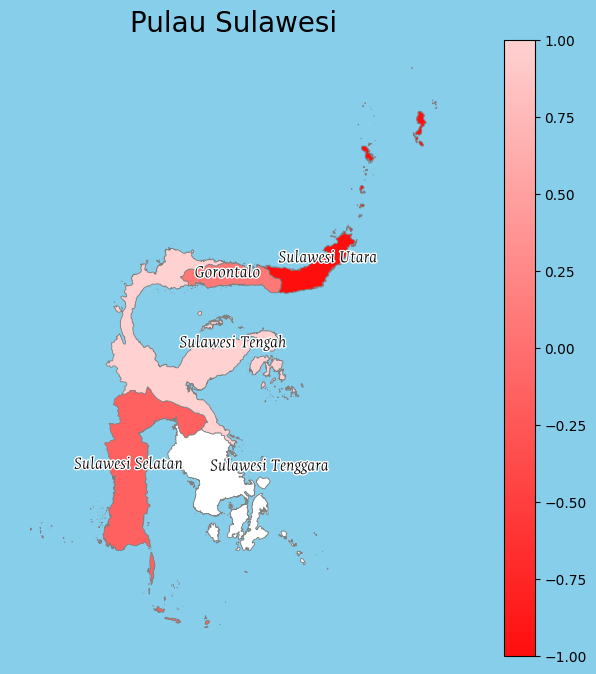

In [ ]:
Sulawesi = ['Sulawesi Utara', 'Sulawesi Tengah', 'Sulawesi Selatan', 'Sulawesi Barat', 'Gorontalo']
Sulawesi_Tenggara = merged['geometry'][28]

sulteng = gpd.GeoDataFrame({
    'province': ['Sulawesi Tenggara'],
    'Hate_Speech': [0],
    'geometry': [Sulawesi_Tenggara]
}, crs="EPSG:4326")

Sulawesi = gabung_hs[gabung_hs['provinsi'].isin(Sulawesi)].copy()

variable = 'Hate_Speech'
vmin, vmax = -1, 1
fig, ax = plt.subplots(1, figsize=(12, 8))
ax.axis('off')

ax.set_title('Pulau Sulawesi', fontdict={'fontsize': '20', 'fontweight': '3'})

sm = plt.cm.ScalarMappable(cmap= red_cmap, norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm.set_array([])
fig.colorbar(sm, ax=ax)

Sulawesi.plot(column=variable, cmap= red_cmap, linewidth= 0.6, ax=ax, edgecolor='gray')
sulteng.plot(column='Hate_Speech', cmap= 'Grays', linewidth= 0.6, ax=ax, edgecolor='gray')


Sulawesi['coords'] = Sulawesi['geometry'].apply(lambda x: x.representative_point().coords[:])
Sulawesi['coords'] = [coords[0] for coords in Sulawesi['coords']]

sulteng['coords'] = sulteng['geometry'].apply(lambda x: x.representative_point().coords[:])
sulteng['coords'] = [coords[0] for coords in sulteng['coords']]

fig.patch.set_facecolor('skyblue')

for idx, row in sulteng.iterrows():
    x, y = row['coords']
    txt = plt.annotate(text=row['province'], xy=row['coords'], horizontalalignment='left', fontproperties=font_prop, fontsize=13)
    txt.set_path_effects([
        path_effects.Stroke(linewidth=2, foreground='white'),
        path_effects.Normal()
    ])

for idx, row in Sulawesi.iterrows():
    txt = plt.annotate(text=row['provinsi'], xy=row['coords'], horizontalalignment='center', fontproperties=font_prop, fontsize=13)
    txt.set_path_effects([
        path_effects.Stroke(linewidth=2, foreground='white'),
        path_effects.Normal()
    ])
